In [1]:
import pandas as pd

In [2]:
ufc = pd.read_csv('data/ufc-master.csv')

In [7]:
for col in ufc.columns:
    print(col)

R_fighter
B_fighter
R_odds
B_odds
R_ev
B_ev
date
location
country
Winner
title_bout
weight_class
gender
no_of_rounds
B_current_lose_streak
B_current_win_streak
B_draw
B_avg_SIG_STR_landed
B_avg_SIG_STR_pct
B_avg_SUB_ATT
B_avg_TD_landed
B_avg_TD_pct
B_longest_win_streak
B_losses
B_total_rounds_fought
B_total_title_bouts
B_win_by_Decision_Majority
B_win_by_Decision_Split
B_win_by_Decision_Unanimous
B_win_by_KO/TKO
B_win_by_Submission
B_win_by_TKO_Doctor_Stoppage
B_wins
B_Stance
B_Height_cms
B_Reach_cms
B_Weight_lbs
R_current_lose_streak
R_current_win_streak
R_draw
R_avg_SIG_STR_landed
R_avg_SIG_STR_pct
R_avg_SUB_ATT
R_avg_TD_landed
R_avg_TD_pct
R_longest_win_streak
R_losses
R_total_rounds_fought
R_total_title_bouts
R_win_by_Decision_Majority
R_win_by_Decision_Split
R_win_by_Decision_Unanimous
R_win_by_KO/TKO
R_win_by_Submission
R_win_by_TKO_Doctor_Stoppage
R_wins
R_Stance
R_Height_cms
R_Reach_cms
R_Weight_lbs
R_age
B_age
lose_streak_dif
win_streak_dif
longest_win_streak_dif
win_dif
loss_

In [4]:
ufc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4495 entries, 0 to 4494
Columns: 137 entries, R_fighter to B_rev_bout
dtypes: bool(1), float64(75), int64(47), object(14)
memory usage: 4.7+ MB


In [8]:
# selecting cols based on intuition
cols = 'R_odds B_odds Winner gender win_streak_dif win_dif loss_dif total_round_dif total_title_bout_dif ko_dif sub_dif height_dif reach_dif age_dif sig_str_dif avg_sub_att_dif avg_td_dif weight_class'.split()

In [9]:
# selecting reduced cols for management
ufc = ufc[cols]
# view information
ufc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4495 entries, 0 to 4494
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   R_odds                4495 non-null   int64  
 1   B_odds                4495 non-null   int64  
 2   Winner                4495 non-null   object 
 3   gender                4495 non-null   object 
 4   win_streak_dif        4495 non-null   int64  
 5   win_dif               4495 non-null   int64  
 6   loss_dif              4495 non-null   int64  
 7   total_round_dif       4495 non-null   int64  
 8   total_title_bout_dif  4495 non-null   int64  
 9   ko_dif                4495 non-null   int64  
 10  sub_dif               4495 non-null   int64  
 11  height_dif            4495 non-null   float64
 12  reach_dif             4495 non-null   float64
 13  age_dif               4495 non-null   int64  
 14  sig_str_dif           4495 non-null   float64
 15  avg_sub_att_dif      

In [10]:
# display winner options
print(ufc['Winner'].unique())
# create function for underdog win vs favorite
def underdog(x):
    if x['B_odds'] > 0 and x['Winner'] == 'Blue':
        return 'Underdog'
    elif x['R_odds'] > 0 and x['Winner'] == 'Red':
        return 'Underdog'
    else:
        return 'Favorite'
# change winner to underdog win or not
ufc['Winner_new'] = ufc.apply(underdog, axis=1)
# view results
print(ufc['Winner_new'].unique())

['Red' 'Blue']
['Favorite' 'Underdog']


<ipython-input-10-8d3d67b265f6>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ufc['Winner_new'] = ufc.apply(underdog, axis=1)


In [11]:
# testing results of the function
ufc[['R_odds', 'B_odds', 'Winner', 'Winner_new']].head()

,R_odds,B_odds,Winner,Winner_new
0,-139,115,Red,Favorite
1,-175,140,Red,Favorite
2,-200,160,Blue,Underdog
3,-177,140,Blue,Underdog
4,-137,110,Blue,Underdog


In [9]:
# import libraries for eda
import matplotlib.pyplot as plt 
import seaborn as sns 

<AxesSubplot:>

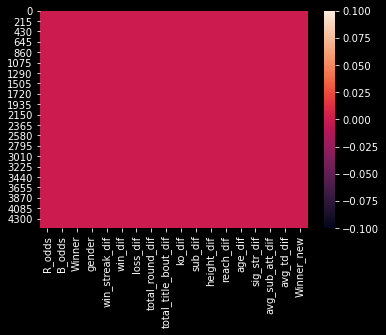

In [10]:
# look for missing values
sns.heatmap(ufc.isna())

<AxesSubplot:xlabel='Winner_new', ylabel='count'>

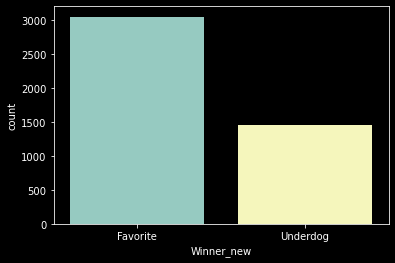

In [11]:
# look at class distributions
sns.countplot(x='Winner_new', data=ufc)

<AxesSubplot:>

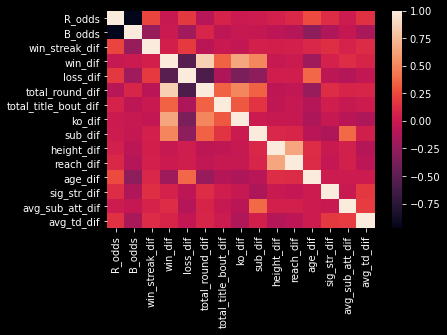

In [12]:
# correlation matrix
sns.heatmap(ufc.corr())

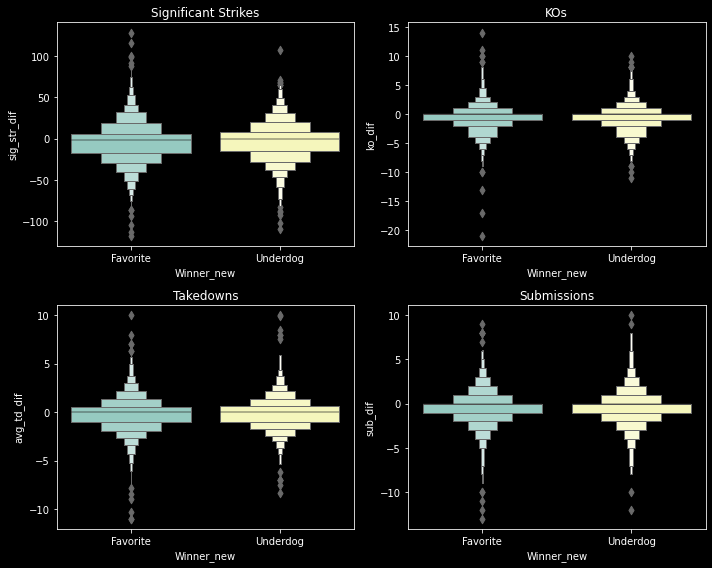

In [13]:
# fight attributes by winner type
# plot size
plt.figure(figsize=(10,8))
# top-left
plt.subplot(2,2,1)
sns.boxenplot(x='Winner_new', y='sig_str_dif', data=ufc)
plt.title('Significant Strikes')
# top-right
plt.subplot(2,2,2)
sns.boxenplot(x='Winner_new', y='ko_dif', data=ufc)
plt.title('KOs')
# lower-left
plt.subplot(2,2,3)
sns.boxenplot(x='Winner_new', y='avg_td_dif', data=ufc)
plt.title('Takedowns')
# lower-right
plt.subplot(2,2,4)
sns.boxenplot(x='Winner_new', y='sub_dif', data=ufc)
plt.title('Submissions')
# nice formatting
plt.tight_layout()

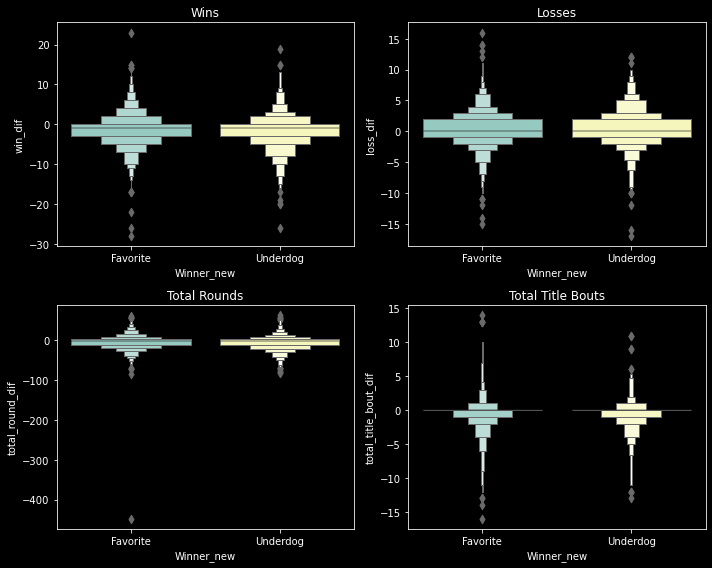

In [14]:
# more fight attributes by winner type
# plot size
plt.figure(figsize=(10,8))
# top-left
plt.subplot(2,2,1)
sns.boxenplot(x='Winner_new', y='win_dif', data=ufc)
plt.title('Wins')
# top-right
plt.subplot(2,2,2)
sns.boxenplot(x='Winner_new', y='loss_dif', data=ufc)
plt.title('Losses')
# lower-left
plt.subplot(2,2,3)
sns.boxenplot(x='Winner_new', y='total_round_dif', data=ufc)
plt.title('Total Rounds')
# lower-right
plt.subplot(2,2,4)
sns.boxenplot(x='Winner_new', y='total_title_bout_dif', data=ufc)
plt.title('Total Title Bouts')
# nice formatting
plt.tight_layout()

Text(0.5, 1.0, 'Submission Attempts')

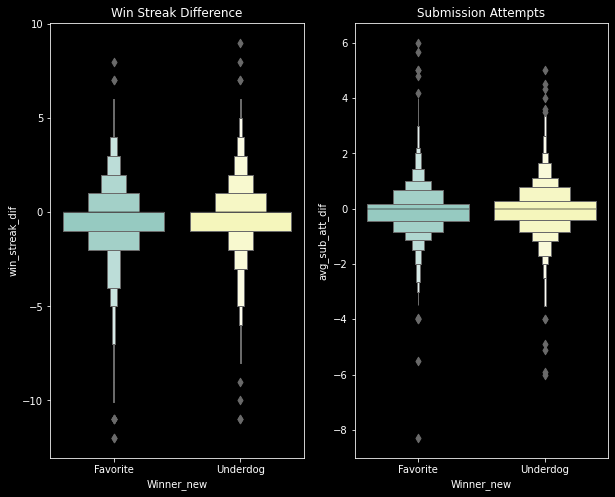

In [15]:
# more fight attributes by winner type
# plot size
plt.figure(figsize=(10,8))
# top-left
plt.subplot(1,2,1)
sns.boxenplot(x='Winner_new', y='win_streak_dif', data=ufc)
plt.title('Win Streak Difference')
# top-right
plt.subplot(1,2,2)
sns.boxenplot(x='Winner_new', y='avg_sub_att_dif', data=ufc)
plt.title('Submission Attempts')

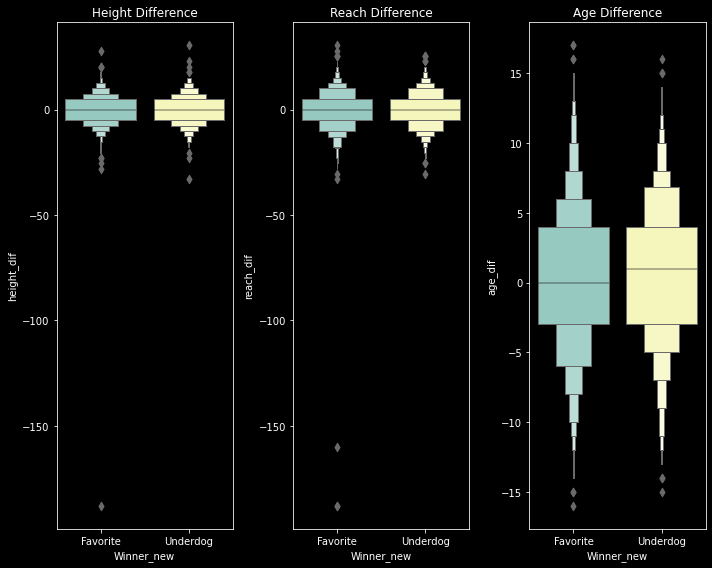

In [16]:
# personal attributes by winner type
# plot size
plt.figure(figsize=(10,8))
# top-left
plt.subplot(1,3,1)
sns.boxenplot(x='Winner_new', y='height_dif', data=ufc)
plt.title('Height Difference')
# top-right
plt.subplot(1,3,2)
sns.boxenplot(x='Winner_new', y='reach_dif', data=ufc)
plt.title('Reach Difference')
# lower-left
plt.subplot(1,3,3)
sns.boxenplot(x='Winner_new', y='age_dif', data=ufc)
plt.title('Age Difference')
# nice formatting
plt.tight_layout()

In [17]:
# # weight class counts
# # set size of plot
# plt.figure(figsize=(10,5))
# # create plot
# sns.countplot(x='weight_class', hue='Winner_new', data=ufc)
# # nice formatting
# plt.xticks(rotation=45)
# plt.tight_layout()

In [18]:
# preparing data for modeling
X = ufc.drop(['Winner', 'Winner_new'], axis=1)
y = ufc['Winner_new']

In [19]:
# creating dummy variables
X = pd.get_dummies(X)
# Xcols = X.columns

In [20]:
from sklearn.model_selection import train_test_split

In [21]:
# creating training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=1)

In [22]:
# import random forest classifier
from sklearn.ensemble import RandomForestClassifier
# import cv for parameter tuning
from sklearn.model_selection import cross_val_score

In [23]:
# create mlflow pipeline
def train(n_estimators):
    '''
    Performs training and logs information to MLflow.
    '''
    import numpy as np
    import mlflow
    import mlflow.sklearn
    # start mlflow instance
    with mlflow.start_run():
        # define model and parameters
        model = RandomForestClassifier(n_estimators=n_estimators)
        # score using 5-fold cross-validation
        score = np.mean(cross_val_score(model, X_train, y_train, cv=5, scoring='f1_weighted'))
        # logging results
        mlflow.log_param("Estimators", n_estimators)
        mlflow.log_metric('F1 Weighted', score)
        mlflow.sklearn.log_model(model, "model")

In [24]:
# # create list of estimators
# estimators = list(range(100, 1100, 100))
# # use new function to find ideal params
# for e in estimators:
#     train(e)

![Training Results](training_results.png) 

In [25]:
# using best params from testing
model = RandomForestClassifier(n_estimators=100)
# fitting to training data
model.fit(X_train, y_train)
# getting predictions
predictions = model.predict(X_test)

In [26]:
from sklearn.metrics import classification_report, confusion_matrix

In [27]:
# viewing results of classification report
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

    Favorite       0.69      0.93      0.79      1002
    Underdog       0.49      0.15      0.23       482

    accuracy                           0.67      1484
   macro avg       0.59      0.54      0.51      1484
weighted avg       0.63      0.67      0.61      1484



In [28]:
# viewing confusion matrix
print(confusion_matrix(y_test, predictions))

[[927  75]
 [410  72]]


In [29]:
# get class probabilities
pred_probs = model.predict_proba(X_test)

In [30]:
# creating df to add predictions
ufc_predicted = X_test.copy()
# add class prediction
ufc_predicted['predicted_winner'] = predictions
# add probability spread
ufc_predicted['predicted_winner_prob_spread'] = list(pred_probs)
# create probabilty cols for readability
ufc_predicted['favorite_win_prob'] = ufc_predicted['predicted_winner_prob_spread'].apply(lambda x: x[0])
ufc_predicted['underdog_win_prob'] = ufc_predicted['predicted_winner_prob_spread'].apply(lambda x: x[1])

In [31]:
ufc_predicted.head()

,R_odds,B_odds,win_streak_dif,win_dif,loss_dif,total_round_dif,total_title_bout_dif,ko_dif,sub_dif,height_dif,...,age_dif,sig_str_dif,avg_sub_att_dif,avg_td_dif,gender_FEMALE,gender_MALE,predicted_winner,predicted_winner_prob_spread,favorite_win_prob,underdog_win_prob
3609,-410,365,-1,0,-3,5,-1,0,-1,5.08,...,-5,1.00,-0.666667,-2.00,0,1,Favorite,"[0.82, 0.18]",0.82,0.18
2084,-155,135,0,-5,0,-5,0,-3,-1,-5.08,...,4,0.50,0.200000,0.90,0,1,Favorite,"[0.61, 0.39]",0.61,0.39
62,-175,138,-2,1,4,14,0,0,0,0.00,...,10,-1.24,-0.400000,1.56,0,1,Underdog,"[0.46, 0.54]",0.46,0.54
44,-770,500,-3,-7,-2,-24,0,-2,-1,-2.54,...,2,-4.69,-0.800000,-0.96,0,1,Favorite,"[0.87, 0.13]",0.87,0.13
1488,-190,165,0,-3,1,-8,0,-1,-1,-5.08,...,-11,-4.20,-0.400000,-0.80,0,1,Favorite,"[0.66, 0.34]",0.66,0.34


In [32]:
# create function to determine return on bet
def ret_bet(x):
    '''
    Creates the return on bet based on circumstance for red.
    '''
    # if fighter is favored
    if x < 0:
        return 100 / abs(x)
    # if fighter is underdog
    else:
        return x / 100

In [33]:
# create return on bet columns with new function
ufc_predicted['ret_bet_B'] = ufc_predicted['B_odds'].apply(ret_bet)
ufc_predicted['ret_bet_R'] = ufc_predicted['R_odds'].apply(ret_bet)

In [34]:
# function to label underdog or favorite
def label_u_f(x):
    '''
    Labels figher as underdog or favorite based on odds before the fight.
    '''
    # if fighter is favored
    if x < 0:
        return 'favorite'
    # if fighter is underdog
    else:
        return 'underdog'

In [35]:
# create labels with new function
ufc_predicted['B_status'] = ufc_predicted['B_odds'].apply(label_u_f)
ufc_predicted['R_status'] = ufc_predicted['R_odds'].apply(label_u_f)

In [36]:
# create expected value function
def ev_underdog(x):
    '''
    Provides the expected value of a bet based on class probabilty for the underdog fighter.
    '''
    if x['B_status'] is 'underdog':
        return x['ret_bet_B'] * x['underdog_win_prob']
    elif x['R_status'] is 'underdog':
        return x['ret_bet_R'] * x['underdog_win_prob']
    else:
        pass

def ev_favorite(x):
    '''
    Provides the expected value of a bet based on class probabilty for the favorite fighter.
    '''
    if x['B_status'] is 'favorite':
        return x['ret_bet_B'] * x['favorite_win_prob']
    elif x['R_status'] is 'favorite':
        return x['ret_bet_R'] * x['favorite_win_prob']
    else:
        pass

In [37]:
# creating expected value columns with new functions
ufc_predicted['ev_underdog'] = ufc_predicted.apply(ev_underdog, axis=1)
ufc_predicted['ev_favorite'] = ufc_predicted.apply(ev_favorite, axis=1)
# view results
ufc_predicted.head()

,R_odds,B_odds,win_streak_dif,win_dif,loss_dif,total_round_dif,total_title_bout_dif,ko_dif,sub_dif,height_dif,...,predicted_winner,predicted_winner_prob_spread,favorite_win_prob,underdog_win_prob,ret_bet_B,ret_bet_R,B_status,R_status,ev_underdog,ev_favorite
3609,-410,365,-1,0,-3,5,-1,0,-1,5.08,...,Favorite,"[0.82, 0.18]",0.82,0.18,3.65,0.243902,underdog,favorite,0.6570,0.200000
2084,-155,135,0,-5,0,-5,0,-3,-1,-5.08,...,Favorite,"[0.61, 0.39]",0.61,0.39,1.35,0.645161,underdog,favorite,0.5265,0.393548
62,-175,138,-2,1,4,14,0,0,0,0.00,...,Underdog,"[0.46, 0.54]",0.46,0.54,1.38,0.571429,underdog,favorite,0.7452,0.262857
44,-770,500,-3,-7,-2,-24,0,-2,-1,-2.54,...,Favorite,"[0.87, 0.13]",0.87,0.13,5.00,0.129870,underdog,favorite,0.6500,0.112987
1488,-190,165,0,-3,1,-8,0,-1,-1,-5.08,...,Favorite,"[0.66, 0.34]",0.66,0.34,1.65,0.526316,underdog,favorite,0.5610,0.347368


In [38]:
# saving this weekend's fights
ufc_tw = pd.read_csv('data/upcoming-event.csv')
# saving names of fighters for later
names = ufc_tw[['R_fighter', 'B_fighter']]
# selecting cols model trained on
ufc_tw = ufc_tw[cols]

In [39]:
# change winner to underdog win or not
ufc_tw['Winner_new'] = ufc_tw.apply(underdog, axis=1)

In [40]:
# preparing data for modeling
X = ufc_tw.drop(['Winner', 'Winner_new'], axis=1)
y = ufc_tw['Winner_new']

In [41]:
# creating dummy variables
X = pd.get_dummies(X)

In [42]:
# getting predictions
predictions = model.predict(X)
# class probabilities
pred_probs = model.predict_proba(X)

In [43]:
# add class prediction
ufc_tw['predicted_winner'] = predictions
# add probability spread
ufc_tw['predicted_winner_prob_spread'] = list(pred_probs)
# create probabilty cols for readability
ufc_tw['favorite_win_prob'] = ufc_tw['predicted_winner_prob_spread'].apply(lambda x: x[0])
ufc_tw['underdog_win_prob'] = ufc_tw['predicted_winner_prob_spread'].apply(lambda x: x[1])
# create return on bet columns with new function
ufc_tw['ret_bet_B'] = ufc_tw['B_odds'].apply(ret_bet)
ufc_tw['ret_bet_R'] = ufc_tw['R_odds'].apply(ret_bet)
# create labels with new function
ufc_tw['B_status'] = ufc_tw['B_odds'].apply(label_u_f)
ufc_tw['R_status'] = ufc_tw['R_odds'].apply(label_u_f)
# creating expected value columns with new functions
ufc_tw['ev_underdog'] = ufc_tw.apply(ev_underdog, axis=1)
ufc_tw['ev_favorite'] = ufc_tw.apply(ev_favorite, axis=1)

In [44]:
# dropping empty winner column
ufc_tw.drop('Winner', axis=1, inplace=True)
# adding names back to data
weekend_preds = pd.concat([ufc_tw, names], axis=1)
# getting cols we want
cols_final = 'R_fighter B_fighter R_odds B_odds R_status B_status predicted_winner favorite_win_prob underdog_win_prob ret_bet_B ret_bet_R ev_underdog ev_favorite'.split()
weekend_preds = weekend_preds[cols_final]

In [45]:
# final results
weekend_preds

,R_fighter,B_fighter,R_odds,B_odds,R_status,B_status,predicted_winner,favorite_win_prob,underdog_win_prob,ret_bet_B,ret_bet_R,ev_underdog,ev_favorite
0,Jack Hermansson,Marvin Vettori,110,-134,underdog,favorite,Underdog,0.47,0.53,0.746269,1.100000,0.5830,0.350746
1,Ovince Saint Preux,Jamahal Hill,140,-177,underdog,favorite,Underdog,0.49,0.51,0.564972,1.400000,0.7140,0.276836
2,Gabriel Benitez,Justin Jaynes,-215,170,favorite,underdog,Favorite,0.58,0.42,1.700000,0.465116,0.7140,0.269767
3,Montana De La Rosa,Taila Santos,175,-225,underdog,favorite,Favorite,0.57,0.43,0.444444,1.750000,0.7525,0.253333
4,Roman Dolidze,John Allan,-200,160,favorite,underdog,Favorite,0.66,0.34,1.600000,0.500000,0.5440,0.330000
5,Nate Landwehr,Movsar Evloev,400,-590,underdog,favorite,Favorite,0.64,0.36,0.169492,4.000000,1.4400,0.108475
6,Louis Smolka,Jose Quinonez,-139,112,favorite,underdog,Favorite,0.58,0.42,1.120000,0.719424,0.4704,0.417266
7,Matt Wiman,Jordan Leavitt,310,-420,underdog,favorite,Favorite,0.77,0.23,0.238095,3.100000,0.7130,0.183333
8,Jimmy Flick,Cody Durden,-182,145,favorite,underdog,Favorite,0.63,0.37,1.450000,0.549451,0.5365,0.346154
9,Ilia Topuria,Damon Jackson,-275,210,favorite,underdog,Favorite,0.62,0.38,2.100000,0.363636,0.7980,0.225455


In [46]:
# saving predictions
weekend_preds.to_csv('data/UFC Weekend Prediction 12-4-2020.csv', index=False)

## Deep Learning Time

In [1]:
import torch
import torch.nn as nn

In [2]:
import pandas as pd

In [3]:
ufc = pd.read_csv('data/ufc-master.csv')

In [4]:
ufc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4495 entries, 0 to 4494
Columns: 137 entries, R_fighter to B_rev_bout
dtypes: bool(1), float64(75), int64(47), object(14)
memory usage: 4.7+ MB


In [5]:
# selecting cols based on intuition
cols = 'R_odds B_odds Winner gender win_streak_dif win_dif loss_dif total_round_dif total_title_bout_dif ko_dif sub_dif height_dif reach_dif age_dif sig_str_dif avg_sub_att_dif avg_td_dif weight_class'.split()

In [6]:
# selecting reduced cols for management
ufc = ufc[cols]
# view information
ufc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4495 entries, 0 to 4494
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   R_odds                4495 non-null   int64  
 1   B_odds                4495 non-null   int64  
 2   Winner                4495 non-null   object 
 3   gender                4495 non-null   object 
 4   win_streak_dif        4495 non-null   int64  
 5   win_dif               4495 non-null   int64  
 6   loss_dif              4495 non-null   int64  
 7   total_round_dif       4495 non-null   int64  
 8   total_title_bout_dif  4495 non-null   int64  
 9   ko_dif                4495 non-null   int64  
 10  sub_dif               4495 non-null   int64  
 11  height_dif            4495 non-null   float64
 12  reach_dif             4495 non-null   float64
 13  age_dif               4495 non-null   int64  
 14  sig_str_dif           4495 non-null   float64
 15  avg_sub_att_dif      

In [7]:
# display winner options
print(ufc['Winner'].unique())
# create function for underdog win vs favorite
def underdog(x):
    if x['B_odds'] > 0 and x['Winner'] == 'Blue':
        return 'Underdog'
    elif x['R_odds'] > 0 and x['Winner'] == 'Red':
        return 'Underdog'
    else:
        return 'Favorite'
# change winner to underdog win or not
ufc['Winner_new'] = ufc.apply(underdog, axis=1)
# view results
print(ufc['Winner_new'].unique())

['Red' 'Blue']
['Favorite' 'Underdog']


In [8]:
ufc.columns

Index(['R_odds', 'B_odds', 'Winner', 'gender', 'win_streak_dif', 'win_dif',
       'loss_dif', 'total_round_dif', 'total_title_bout_dif', 'ko_dif',
       'sub_dif', 'height_dif', 'reach_dif', 'age_dif', 'sig_str_dif',
       'avg_sub_att_dif', 'avg_td_dif', 'weight_class', 'Winner_new'],
      dtype='object')

In [9]:
cat_cols = ['gender', 'weight_class'] # categories
con_cols = ['R_odds', 'B_odds', 'win_streak_dif', 'win_dif',
       'loss_dif', 'total_round_dif', 'total_title_bout_dif', 'ko_dif',
       'sub_dif', 'height_dif', 'reach_dif', 'age_dif', 'sig_str_dif',
       'avg_sub_att_dif', 'avg_td_dif'] # numerical vars
y_col = ['Winner_new'] # target var

print(f'Categorical columns: \t{len(cat_cols)}\nContinuous columns: \t{len(con_cols)}\nY column: \t\t{len(y_col)}')

Categorical columns: 	2
Continuous columns: 	15
Y column: 		1


In [10]:
for col in cat_cols:
    ufc[col] = ufc[col].astype('category') # convert to cat type
    
ufc.dtypes

R_odds                     int64
B_odds                     int64
Winner                    object
gender                  category
win_streak_dif             int64
win_dif                    int64
loss_dif                   int64
total_round_dif            int64
total_title_bout_dif       int64
ko_dif                     int64
sub_dif                    int64
height_dif               float64
reach_dif                float64
age_dif                    int64
sig_str_dif              float64
avg_sub_att_dif          float64
avg_td_dif               float64
weight_class            category
Winner_new                object
dtype: object

In [11]:
import numpy as np

In [12]:
cats = np.stack([ufc[col].cat.codes.values for col in cat_cols], 1)

In [13]:
# Convert categorical variables to a tensor
cats = torch.tensor(cats, dtype=torch.int64)
# this syntax is ok, since the source data is an array, not an existing tensor
cats[:5]

tensor([[1, 5],
        [1, 8],
        [1, 4],
        [1, 2],
        [0, 9]])

In [14]:
# Convert continuous variables to a tensor
conts = np.stack([ufc[col].values for col in con_cols], 1)
conts = torch.tensor(conts, dtype=torch.float)
conts[:5]

tensor([[-139.0000,  115.0000,    2.0000,   -4.0000,   -4.0000,  -21.0000,
           -1.0000,   -6.0000,   -3.0000,  -10.1600,   -2.5400,   -2.0000,
            0.4300,   -0.6000,    2.3500],
        [-175.0000,  140.0000,   -2.0000,   -1.0000,    1.0000,   -1.0000,
            0.0000,    0.0000,    0.0000,  -10.1600,   -2.5400,    2.0000,
           -0.8400,   -1.1000,    0.2500],
        [-200.0000,  160.0000,   -2.0000,   -2.0000,    1.0000,   -1.0000,
            0.0000,   -2.0000,    0.0000,  -10.1600,  -10.1600,    4.0000,
           -0.2500,   -1.7000,    1.2200],
        [-177.0000,  140.0000,    0.0000,   -1.0000,    1.0000,    2.0000,
            0.0000,   -1.0000,    0.0000,   10.1600,    5.0800,    4.0000,
            4.4000,    0.0000,   -2.2400],
        [-137.0000,  110.0000,    0.0000,   -3.0000,   -3.0000,  -16.0000,
            0.0000,   -1.0000,    0.0000,   -2.5400,    0.0000,   -3.0000,
           -3.4400,    0.0000,    2.9700]])

In [15]:
# Convert labels to a tensor
ufc[y_col] = ufc[y_col].astype('category')
y = torch.tensor(ufc['Winner_new'].cat.codes.values, dtype=torch.int64).flatten()
y[:5]

<ipython-input-15-fe86b70167ce>:3: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ..\torch\csrc\utils\tensor_numpy.cpp:141.)
  y = torch.tensor(ufc['Winner_new'].cat.codes.values, dtype=torch.int64).flatten()


tensor([0, 0, 1, 1, 1])

In [16]:
cats.shape

torch.Size([4495, 2])

In [17]:
conts.shape

torch.Size([4495, 15])

In [18]:
y.shape

torch.Size([4495])

In [19]:
# set embedding sizes
cat_szs = [len(ufc[col].cat.categories) for col in cat_cols]
emb_szs = [(size, min(50, (size+1)//2)) for size in cat_szs]
emb_szs

[(2, 1), (13, 7)]

In [20]:
class TabularModel(nn.Module):

    def __init__(self, emb_szs, n_cont, out_sz, layers, p=0.5):
        super().__init__()
        self.embeds = nn.ModuleList([nn.Embedding(ni, nf) for ni,nf in emb_szs])
        self.emb_drop = nn.Dropout(p)
        self.bn_cont = nn.BatchNorm1d(n_cont)
        
        layerlist = []
        n_emb = sum((nf for ni,nf in emb_szs))
        n_in = n_emb + n_cont
        
        for i in layers:
            layerlist.append(nn.Linear(n_in,i)) 
#             layerlist.append(nn.ReLU(inplace=True))
            layerlist.append(nn.Softmax())
            layerlist.append(nn.BatchNorm1d(i))
            layerlist.append(nn.Dropout(p))
            n_in = i
        layerlist.append(nn.Linear(layers[-1],out_sz))
            
        self.layers = nn.Sequential(*layerlist)
    
    def forward(self, x_cat, x_cont):
        embeddings = []
        for i,e in enumerate(self.embeds):
            embeddings.append(e(x_cat[:,i]))
        x = torch.cat(embeddings, 1)
        x = self.emb_drop(x)
        
        x_cont = self.bn_cont(x_cont)
        x = torch.cat([x, x_cont], 1)
        x = self.layers(x)
        return x

In [21]:
torch.manual_seed(33)
model = TabularModel(emb_szs, conts.shape[1], 2, [200,100], p=0.4) # out_sz = 2

In [22]:
model

TabularModel(
  (embeds): ModuleList(
    (0): Embedding(2, 1)
    (1): Embedding(13, 7)
  )
  (emb_drop): Dropout(p=0.35, inplace=False)
  (bn_cont): BatchNorm1d(15, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (layers): Sequential(
    (0): Linear(in_features=23, out_features=200, bias=True)
    (1): Softmax(dim=None)
    (2): BatchNorm1d(200, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): Dropout(p=0.35, inplace=False)
    (4): Linear(in_features=200, out_features=100, bias=True)
    (5): Softmax(dim=None)
    (6): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): Dropout(p=0.35, inplace=False)
    (8): Linear(in_features=100, out_features=2, bias=True)
  )
)

In [23]:
criterion = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [24]:
batch_size = 4495
test_size = 500

cat_train = cats[:batch_size-test_size]
cat_test = cats[batch_size-test_size:batch_size]
con_train = conts[:batch_size-test_size]
con_test = conts[batch_size-test_size:batch_size]
y_train = y[:batch_size-test_size]
y_test = y[batch_size-test_size:batch_size]

In [25]:
len(cat_train)

3995

In [26]:
len(cat_test)

500

In [27]:
y_train

tensor([0, 0, 1,  ..., 1, 0, 1])

In [28]:
import time
start_time = time.time()

epochs = 200
losses = []

for i in range(epochs):
    i+=1
    y_pred = model(cat_train, con_train)
    loss = criterion(y_pred, y_train)
    losses.append(loss)
    
    # a neat trick to save screen space:
    if i%50 == 1:
        print(f'epoch: {i:3}  loss: {loss.item():10.8f}')

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

print(f'epoch: {i:3}  loss: {loss.item():10.8f}') # print the last line
print(f'\nDuration: {time.time() - start_time:.0f} seconds') # print the time elapsed

C:\Users\jpzam\Anaconda3\lib\site-packages\torch\nn\modules\container.py:117: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


epoch:   1  loss: 0.75485867
epoch:  51  loss: 0.63220841
epoch: 101  loss: 0.59306693
epoch: 151  loss: 0.57673079
epoch: 200  loss: 0.56605679

Duration: 10 seconds


In [29]:
# TO EVALUATE THE ENTIRE TEST SET
with torch.no_grad():
    y_val = model(cat_test, con_test)
    loss = criterion(y_val, y_test)
print(f'CE Loss: {loss:.8f}')

CE Loss: 0.62688708


In [30]:
rows = len(y_test)
correct = 0
for i in range(rows):
    if y_val[i].argmax().item() == y_test[i]:
        correct += 1
print(f'\n{correct} out of {rows} = {100*correct/rows:.2f}% correct')


319 out of 500 = 63.80% correct


In [31]:
preds = []
for i in range(rows):
    preds.append(y_val[i].argmax().item())
preds = np.array(preds)

In [32]:
y_true = y_test.numpy()

In [33]:
from sklearn.metrics import classification_report

In [34]:
print(classification_report(y_true, preds))

              precision    recall  f1-score   support

           0       0.69      0.83      0.76       339
           1       0.39      0.22      0.28       161

    accuracy                           0.64       500
   macro avg       0.54      0.53      0.52       500
weighted avg       0.60      0.64      0.61       500



In [35]:
from sklearn.metrics import confusion_matrix

In [36]:
print(confusion_matrix(y_true, preds))

[[283  56]
 [125  36]]
